# Finding RNAfish spots in 256x256 images using Unet, Conv2d

In [127]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import tensorflow as tf
from scipy.optimize import curve_fit
import skimage
from PIL import Image
import random
import utils
import shutil

In [128]:
data='/n/projects/smc/public/SMC/DLMacro/Muscles/'

# Get data

Load data from file

In [140]:
both=skimage.external.tifffile.imread(data+'Training_RotShift.tif')
both=np.swapaxes(np.swapaxes(both,1,2), 2,3)

x_dim=both.shape[1]
y_dim=both.shape[2]


In [148]:
train_data=both[:,:,:,[0]]/655350.0
train_truth=both[:,:,:,[1,2]]

non_zeros=np.where(train_data!=0)
mean=np.mean(train_data[non_zeros])
std=np.std(train_data[non_zeros])


train_data=(train_data-mean)/(std*1)+0.5
train_truth[np.where(train_truth>0.1)]=1

validation=skimage.external.tifffile.imread(data+'Validation_annotated.tif')
validation=np.swapaxes(np.swapaxes(validation,1,2), 2,3)

validation_data=validation[:,:,:,[0]]/655350.0
validation_data=(validation_data-mean)/(std*1)+0.5

validation_truth=validation[:,:,:,[1,2]]
validation_truth[np.where(validation_truth>0.1)]=1


In [142]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
file.close()
print([base_scaler, baseline_noise])

[32, 0.53]


In [144]:
print([mean, std])

[0.019410765, 0.019121418]


# Design network

Define a function to create a convolutional layer, including conv, relu, maxpool, that can be called multiple times

In [149]:
tf.reset_default_graph()
#Input and output
x=tf.placeholder(dtype=tf.float32, shape=[None, x_dim,y_dim,1], name='x')
y=tf.placeholder(dtype=tf.float32, shape=[None, x_dim,y_dim,2], name='y')
lr=tf.placeholder(dtype=tf.float32, shape=[], name='learning_rate')
dr=tf.placeholder(dtype=tf.float32, shape=[], name='dropout_rate')

regularizer = tf.contrib.layers.l2_regularizer(scale=0.1)

xr=x
yr=y

#base_scaler=32

#Going down
A1=utils.leaky_relu(tf.layers.conv2d(xr, base_scaler, [5,5], padding='SAME', kernel_regularizer=regularizer))
A2=utils.leaky_relu(tf.layers.conv2d(A1, base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

B0=tf.nn.max_pool(A2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
B1=utils.leaky_relu(tf.layers.conv2d(B0, 2*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
B2=utils.leaky_relu(tf.layers.conv2d(B1, 2*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

C0=tf.nn.max_pool(B2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
C1=utils.leaky_relu(tf.layers.conv2d(C0, 4*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
C2=utils.leaky_relu(tf.layers.conv2d(C1, 4*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

D0=tf.nn.max_pool(C2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
D1=utils.leaky_relu(tf.layers.conv2d(D0, 8*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
D2=utils.leaky_relu(tf.layers.conv2d(D1, 8*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

E0=tf.nn.max_pool(D2, ksize=[1,2,2,1], strides=[1,2,2,1], padding='SAME')
E1=utils.leaky_relu(tf.layers.conv2d(E0, 16*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
E2=utils.leaky_relu(tf.layers.conv2d(E1, 16*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

#Coming up
DD0=tf.layers.conv2d_transpose(E2, 8*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
DD1=tf.concat(axis=3, values=[DD0,D2])
DD2=utils.leaky_relu(tf.layers.conv2d(DD1, 8*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
DD3=utils.leaky_relu(tf.layers.conv2d(DD2, 8*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

CC0=tf.layers.conv2d_transpose(DD3, 4*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
CC1=tf.concat(axis=3, values=[CC0,C2])
CC2=utils.leaky_relu(tf.layers.conv2d(CC1, 4*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
CC3=utils.leaky_relu(tf.layers.conv2d(CC2, 4*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

BB0=tf.layers.conv2d_transpose(CC3, 2*base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
#BB0=tf.contrib.layers.conv2d_transpose(C2, 2*base_scaler, kernel_size=[3,3], stride=[2, 2], padding='SAME')
BB1=tf.concat(axis=3, values=[BB0,B2])
BB2=utils.leaky_relu(tf.layers.conv2d(BB1, 2*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
BB3=utils.leaky_relu(tf.layers.conv2d(BB2, 2*base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

AA0=tf.layers.conv2d_transpose(BB3, base_scaler, kernel_size=[3,3], strides=[2, 2], padding='SAME')
AA1=tf.concat(axis=3, values=[AA0,A2])
AA2=utils.leaky_relu(tf.layers.conv2d(AA1, base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))
AA3=utils.leaky_relu(tf.layers.conv2d(AA2, base_scaler, [3,3], padding='SAME', kernel_regularizer=regularizer))

logits=utils.leaky_relu(tf.layers.conv2d(AA3, 2, [1,1], padding='SAME', kernel_regularizer=regularizer))
probs=tf.tanh(logits, name='probabilities')

diff=tf.subtract(probs, yr)
LSQ=tf.multiply(diff,diff)
#Added this to make the outlines more potent in error function
OutError, MaskError=tf.split(LSQ, [1,1], 3)
loss=1*tf.reduce_mean(OutError)+0.1*tf.reduce_mean(MaskError)
loss=tf.reduce_mean(LSQ, name='error')
l2_loss = tf.losses.get_regularization_loss()
#loss=loss+l2_loss/1000

train_op=tf.train.AdamOptimizer(learning_rate=lr, name='trainer').minimize(loss)

tf.summary.scalar('loss', loss)
tf.summary.image('input', x, 3)
tf.summary.image('standard', tf.reshape(y[:,:,:,0], [-1, x_dim, y_dim,1]) , 3)
tf.summary.image('outline', tf.reshape(probs[:,:,:,0], [-1, x_dim, y_dim,1]), 3)
tf.summary.image('mask', tf.reshape(probs[:,:,:,1], [-1, x_dim, y_dim,1]), 3)


merge = tf.summary.merge_all()

# Training on easy set

0
Training loss:  0.12017885
(3, 256, 256, 2)
Validation loss:  0.2704954


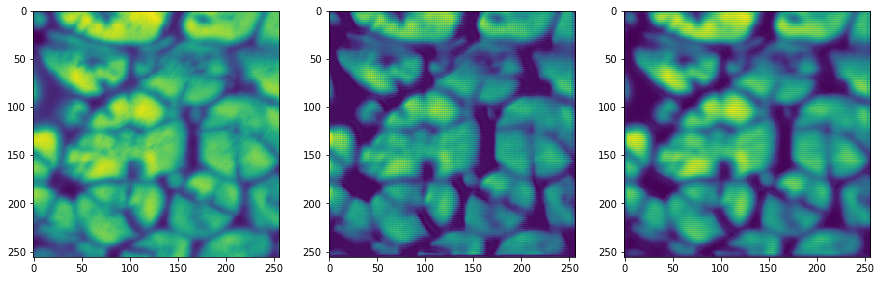

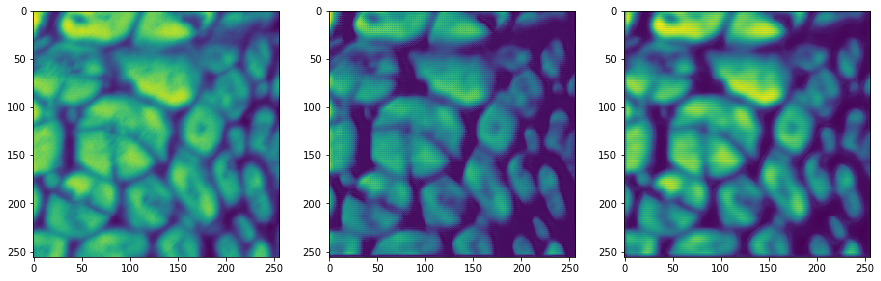

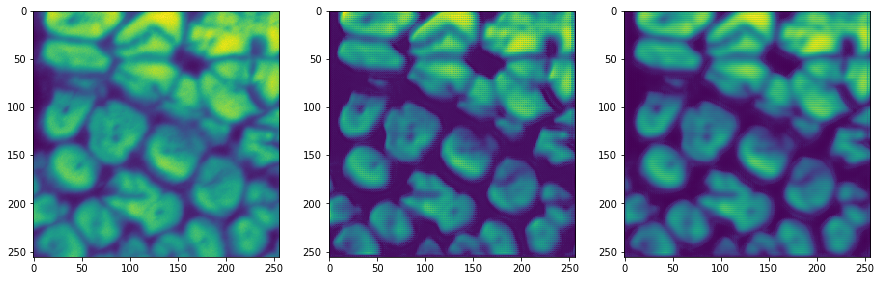

100
Training loss:  0.051390596
(3, 256, 256, 2)
Validation loss:  0.10248055


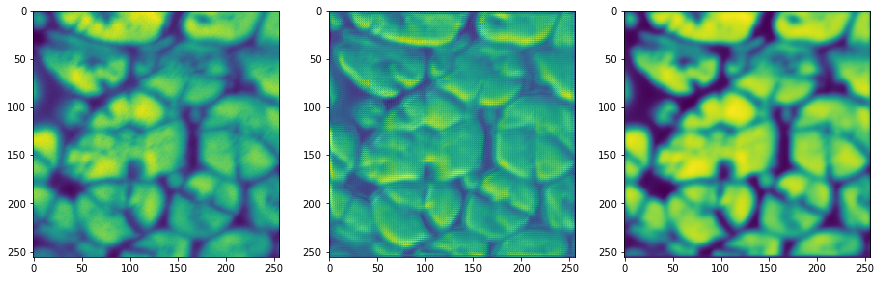

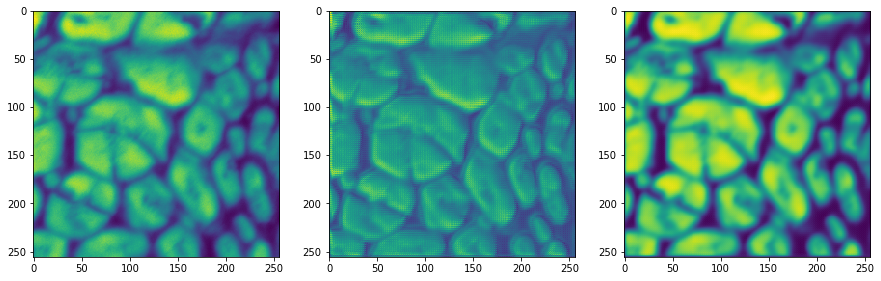

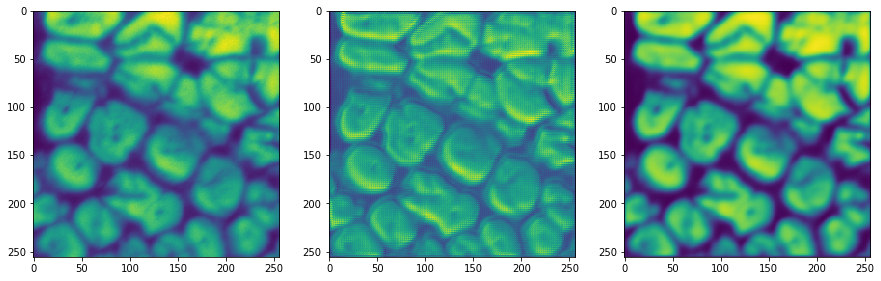

200
Training loss:  0.076559804
(3, 256, 256, 2)
Validation loss:  0.08056172


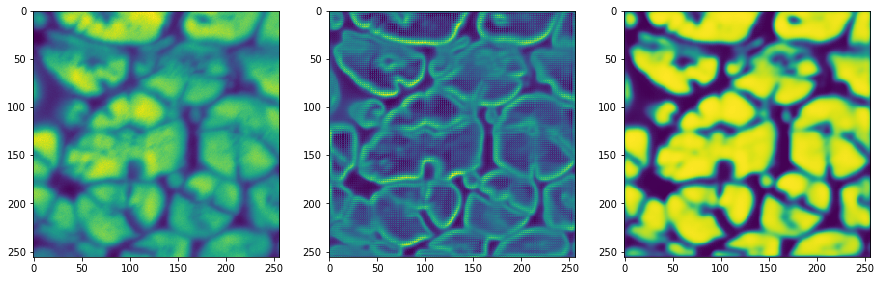

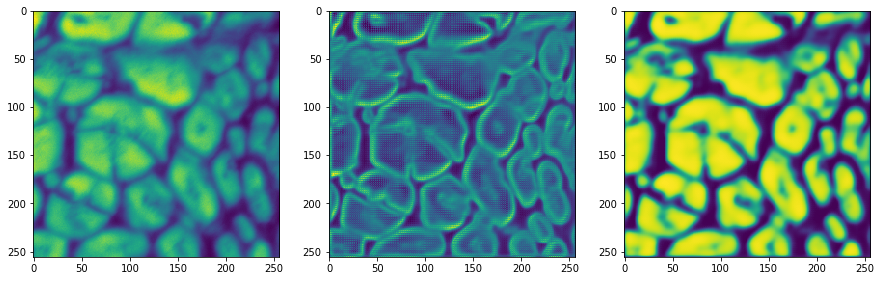

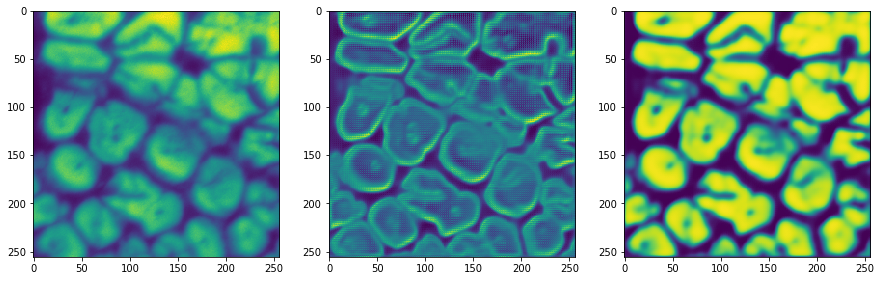

300
Training loss:  0.042150117
(3, 256, 256, 2)
Validation loss:  0.08350807


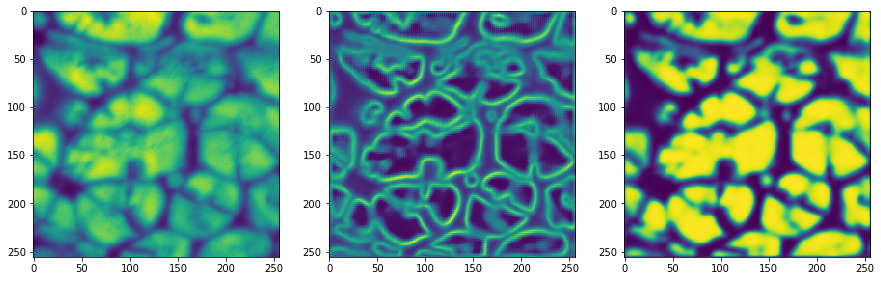

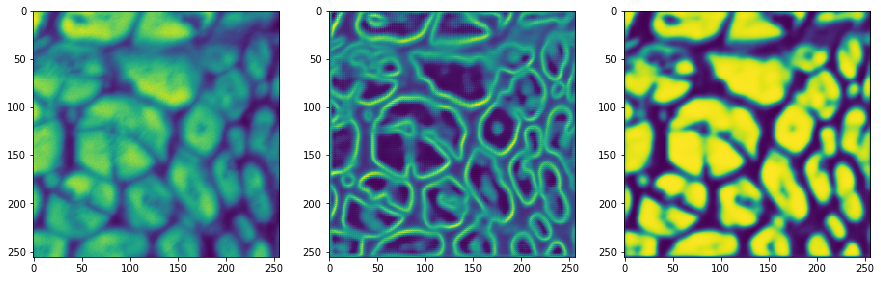

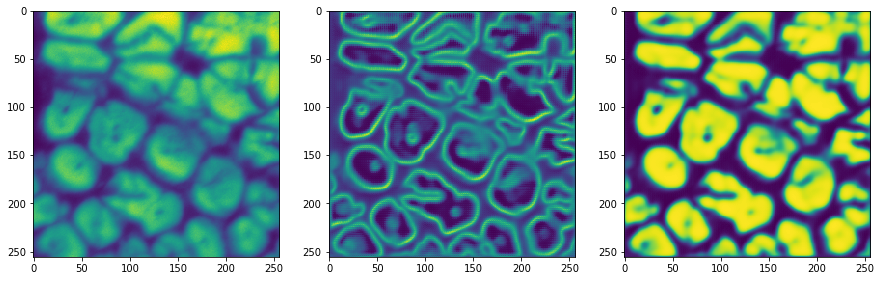

400
Training loss:  0.06922089
(3, 256, 256, 2)
Validation loss:  0.081236355


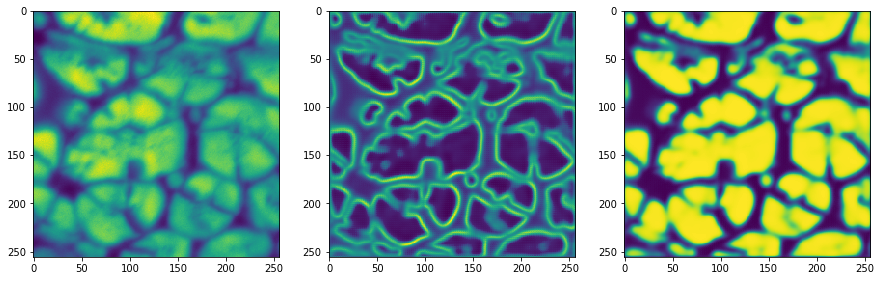

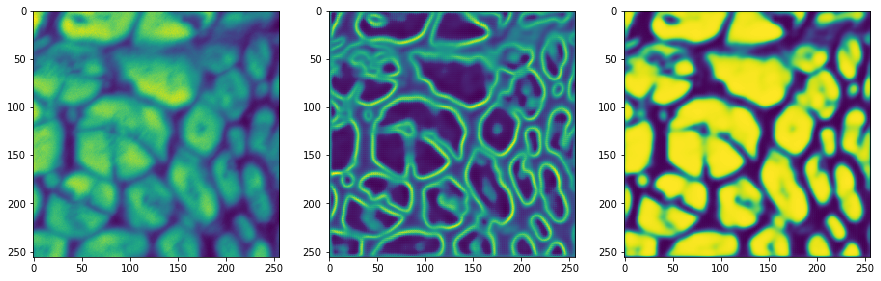

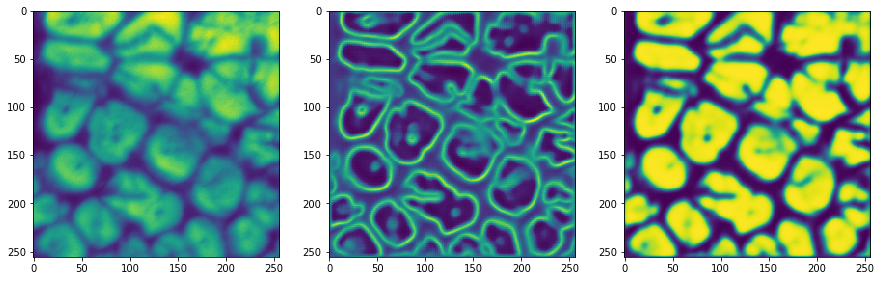

500
Training loss:  0.03558304
(3, 256, 256, 2)
Validation loss:  0.07846781


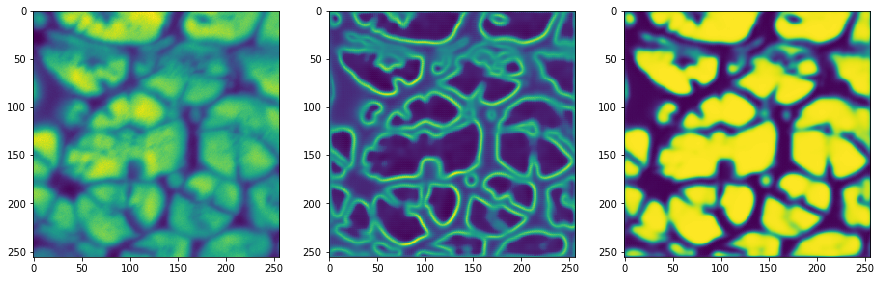

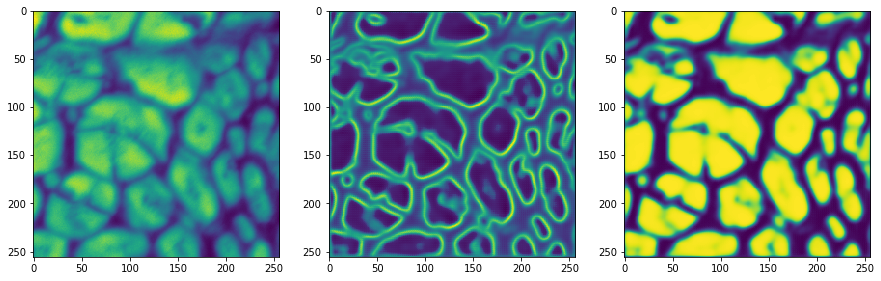

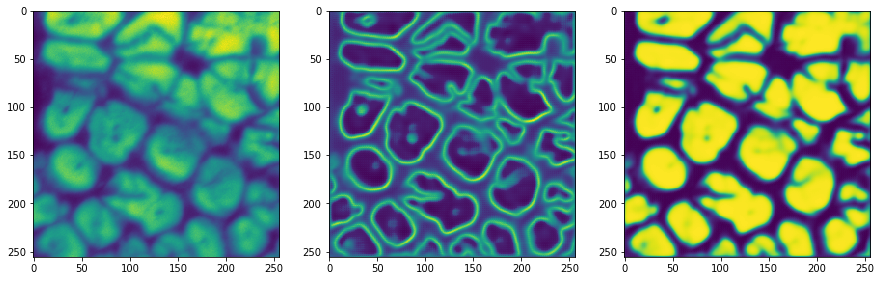

600
Training loss:  0.05073245
(3, 256, 256, 2)
Validation loss:  0.075726554


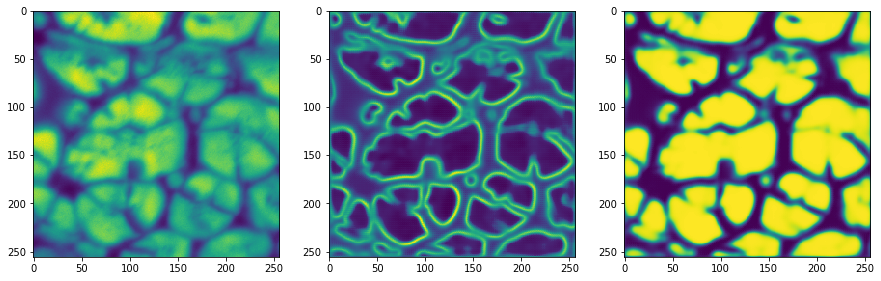

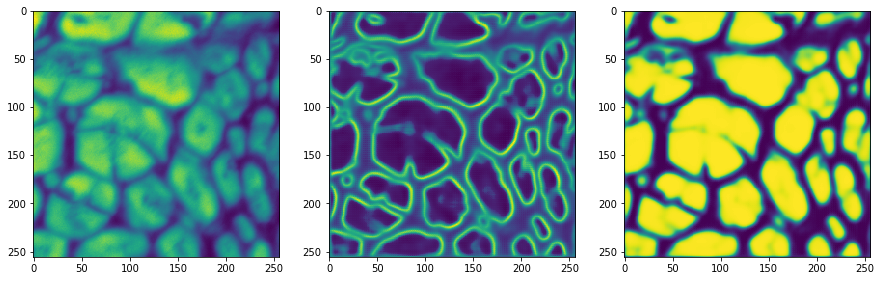

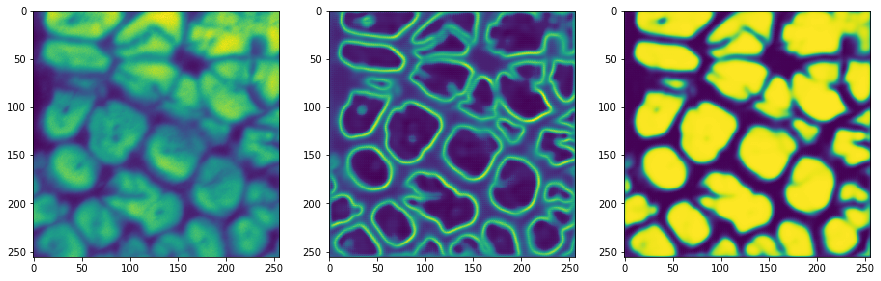

700
Training loss:  0.049277544
(3, 256, 256, 2)
Validation loss:  0.07539173


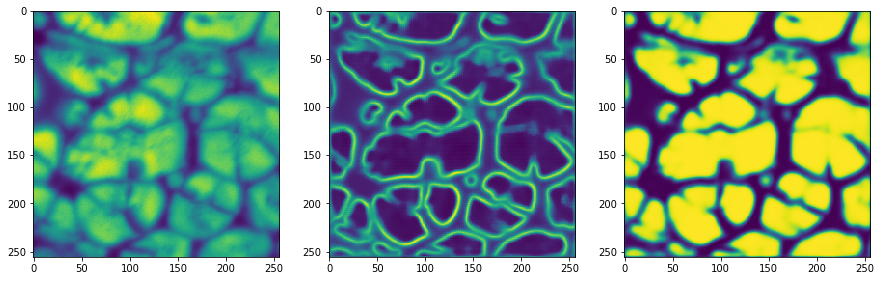

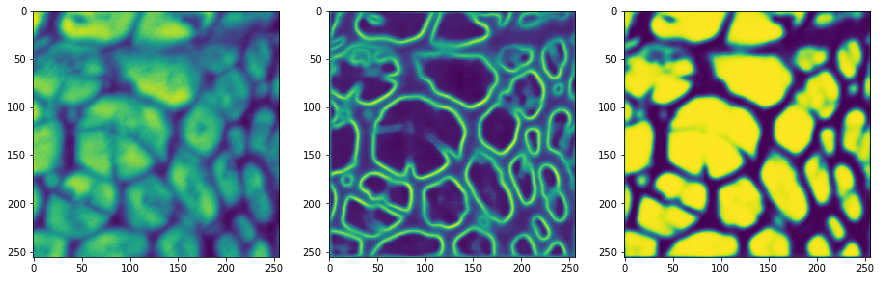

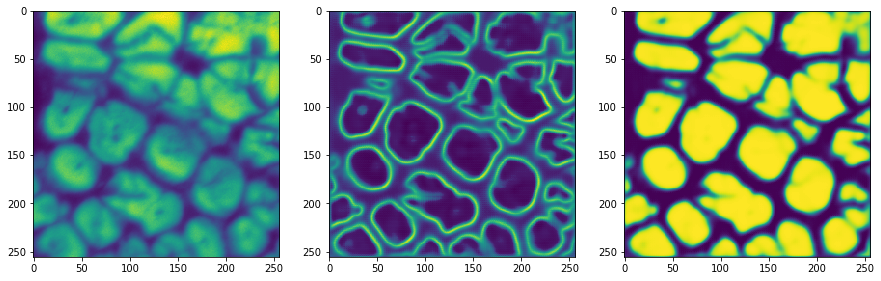

800
Training loss:  0.047707178
(3, 256, 256, 2)
Validation loss:  0.07542188


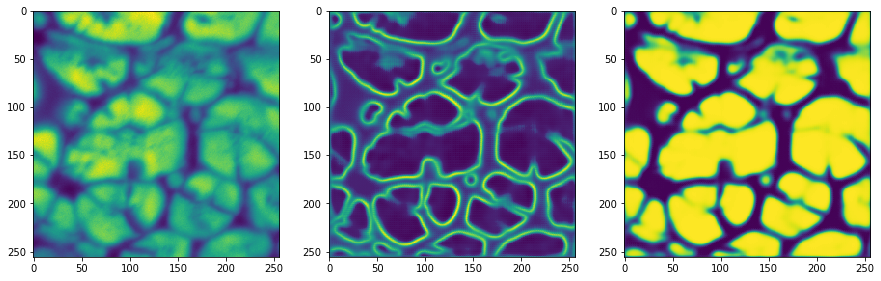

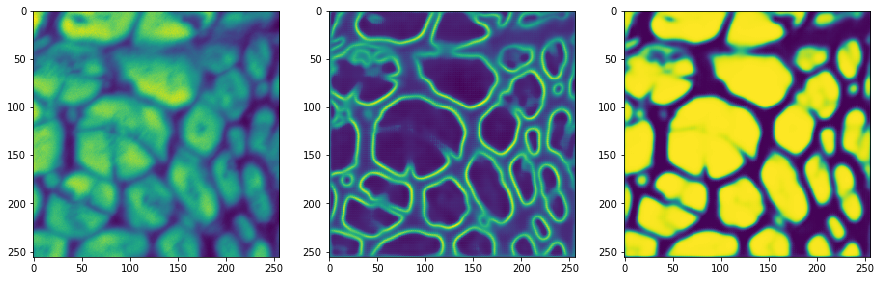

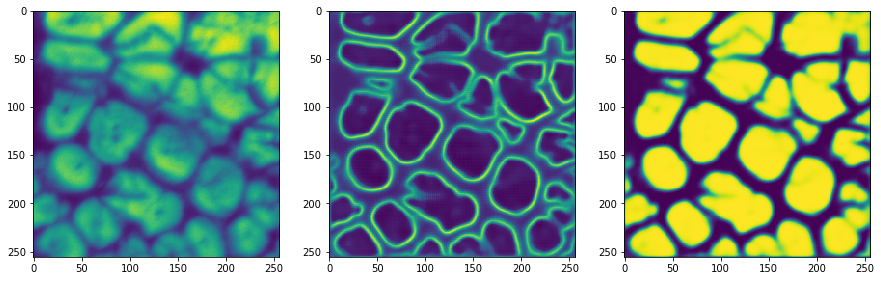

900
Training loss:  0.038608875
(3, 256, 256, 2)
Validation loss:  0.07597605


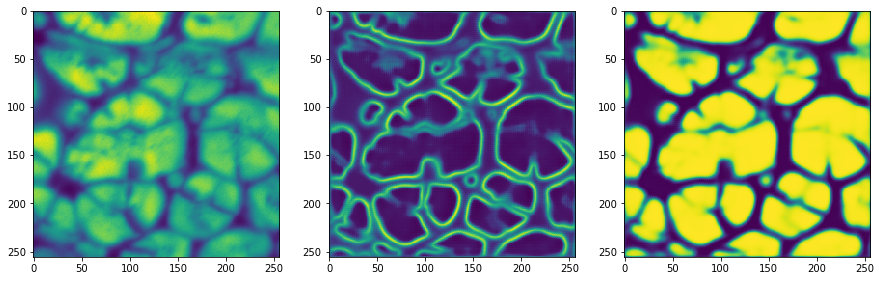

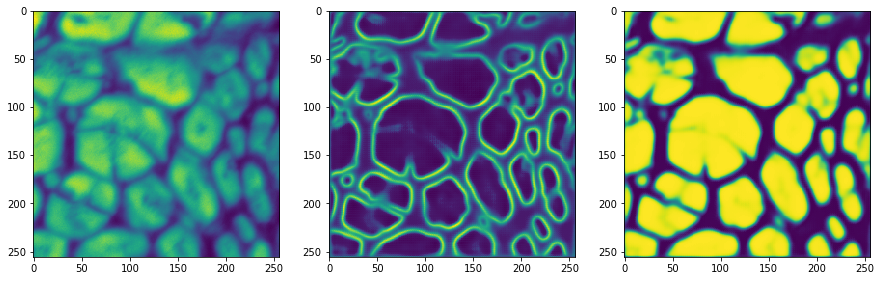

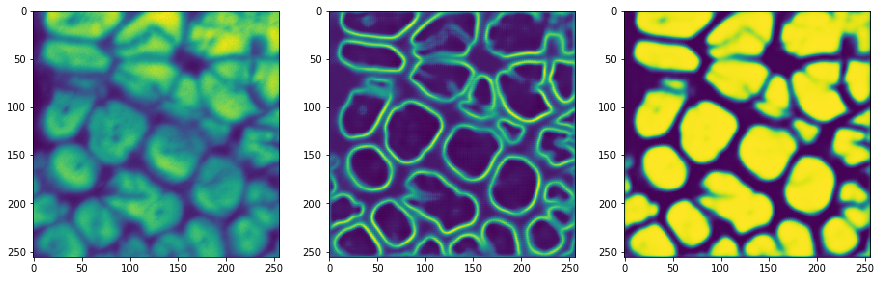

1000
Training loss:  0.04131196
(3, 256, 256, 2)
Validation loss:  0.07520562


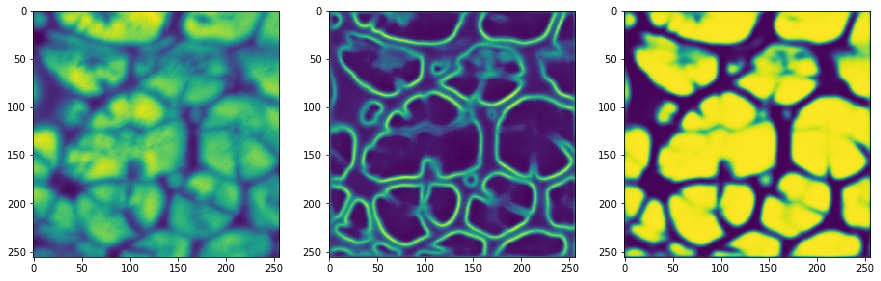

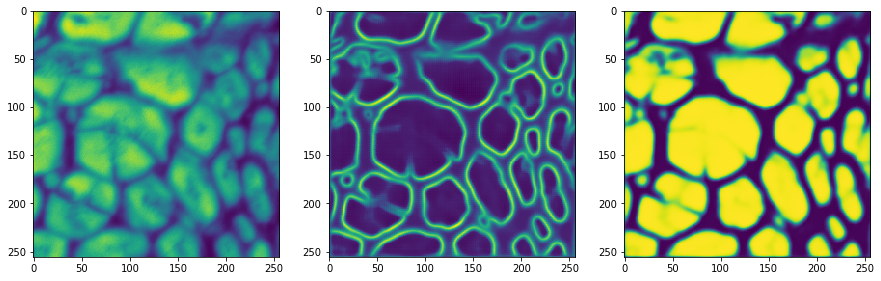

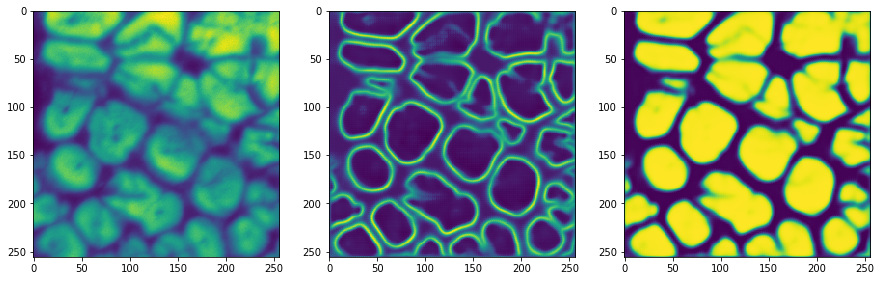

1100
Training loss:  0.037540514
(3, 256, 256, 2)
Validation loss:  0.074087195


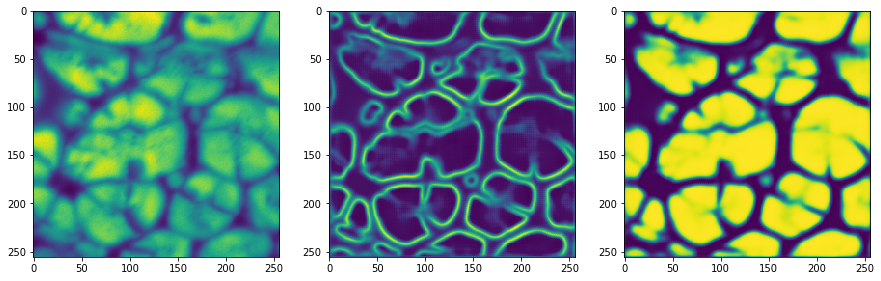

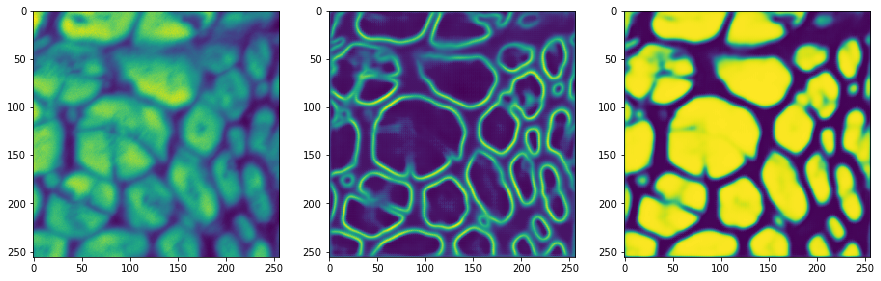

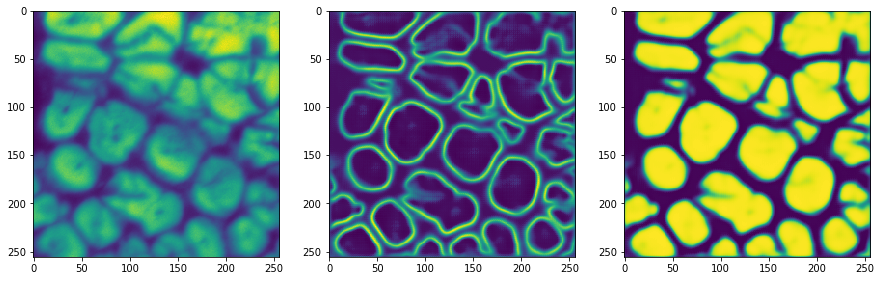

1200
Training loss:  0.041125145
(3, 256, 256, 2)
Validation loss:  0.073063426


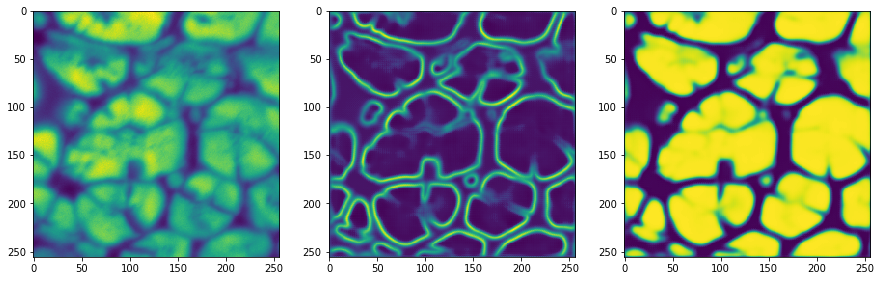

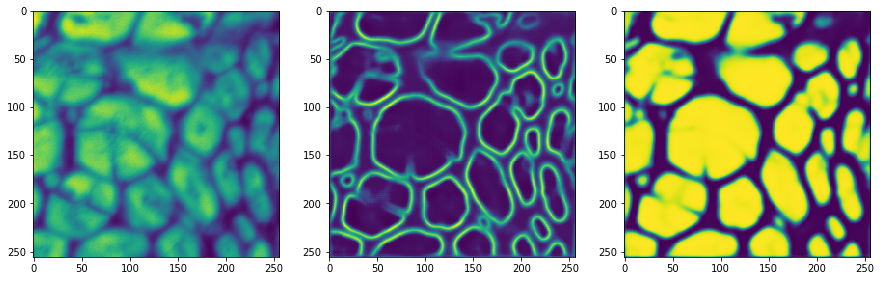

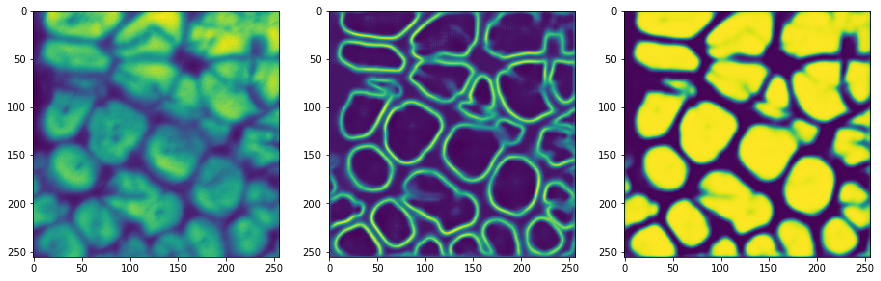

1300
Training loss:  0.042102512
(3, 256, 256, 2)
Validation loss:  0.073158786


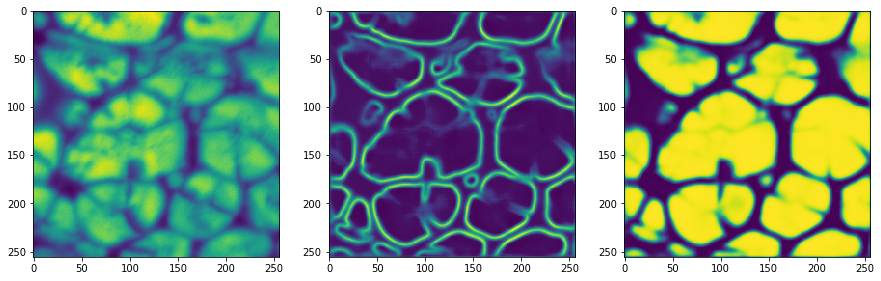

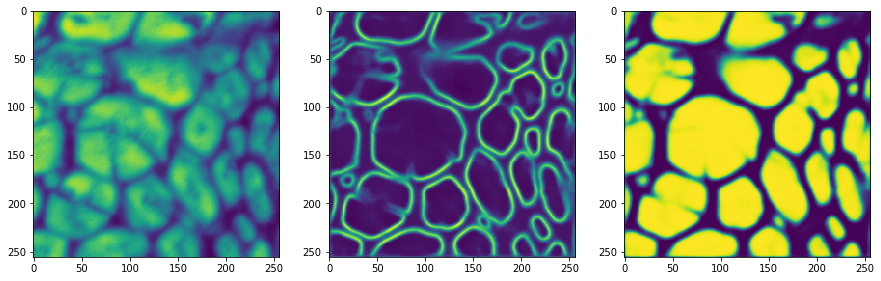

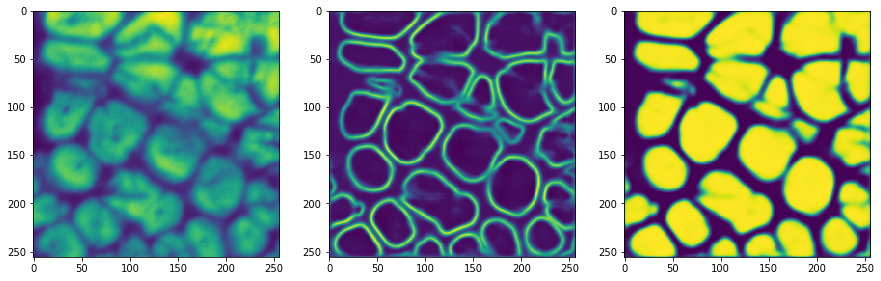

1400
Training loss:  0.03096424
(3, 256, 256, 2)
Validation loss:  0.071611784


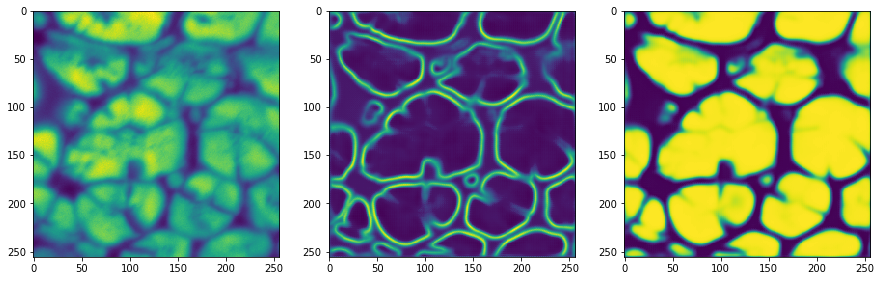

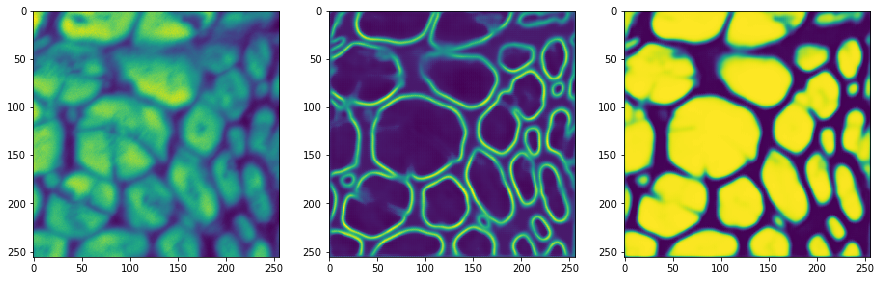

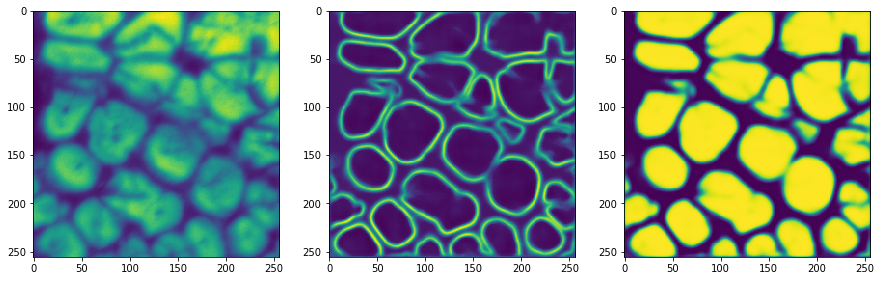

1500
Training loss:  0.03620706
(3, 256, 256, 2)
Validation loss:  0.07195439


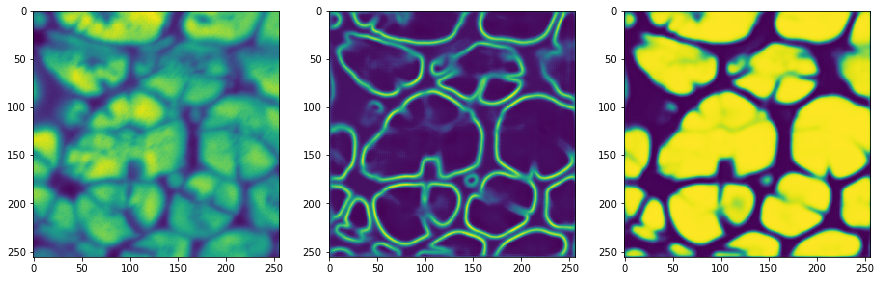

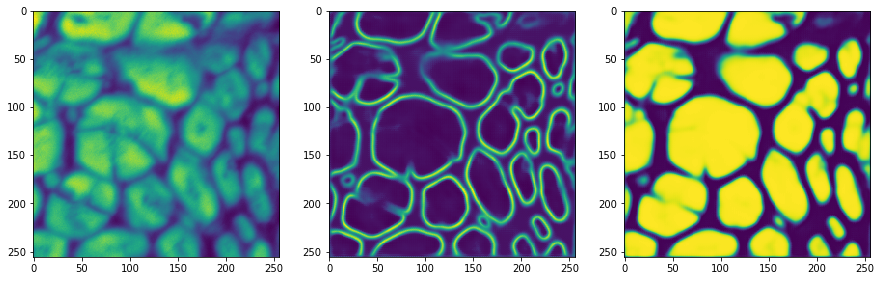

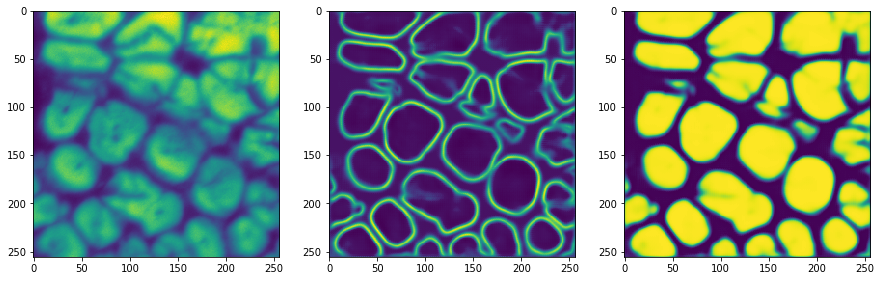

1600
Training loss:  0.027957544
(3, 256, 256, 2)
Validation loss:  0.07339988


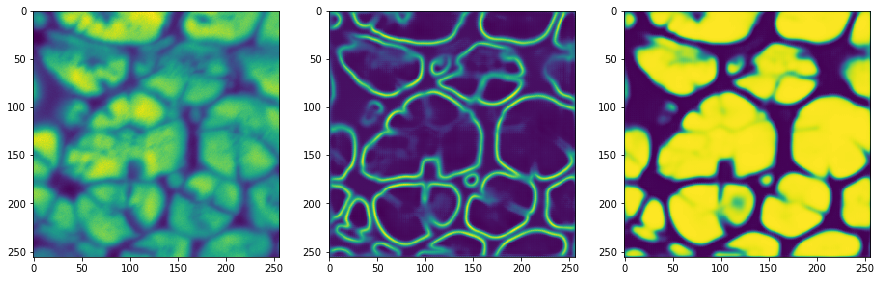

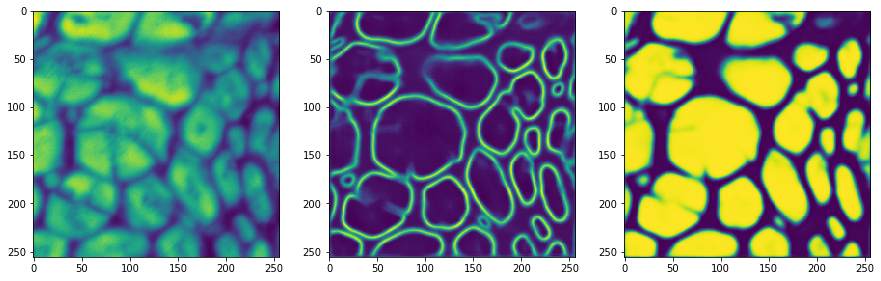

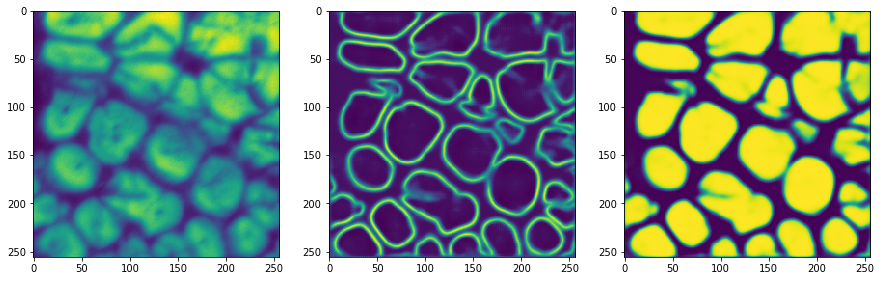

1700
Training loss:  0.032446694
(3, 256, 256, 2)
Validation loss:  0.07470976


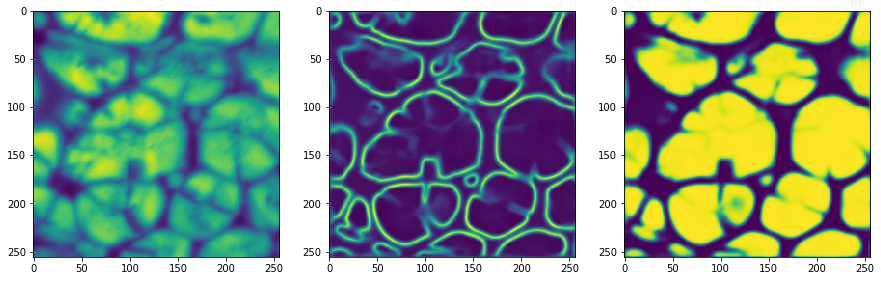

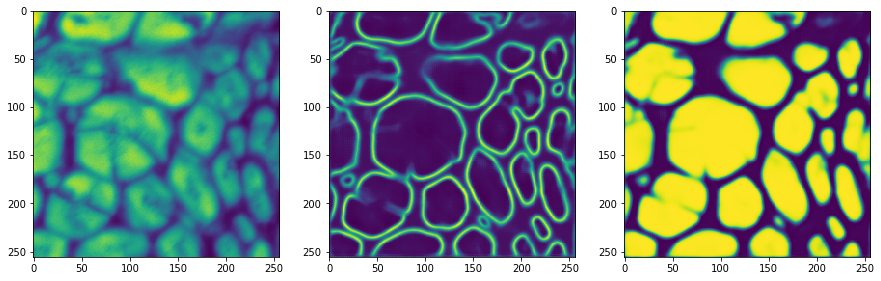

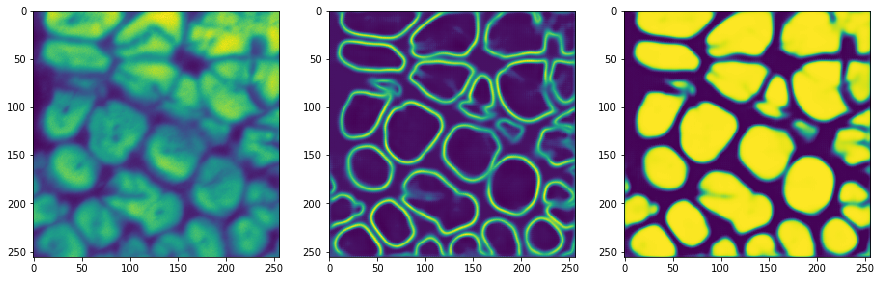

1800
Training loss:  0.029742923
(3, 256, 256, 2)
Validation loss:  0.07452198


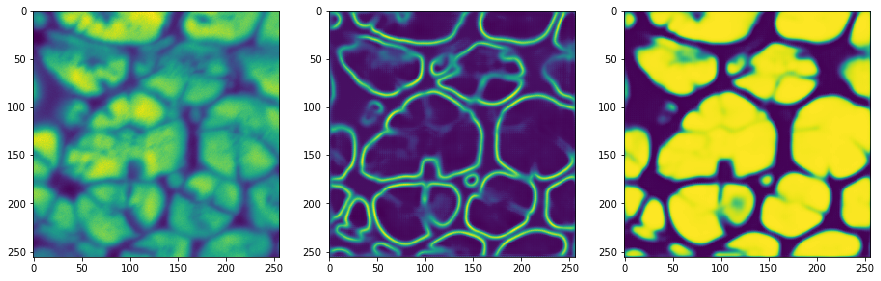

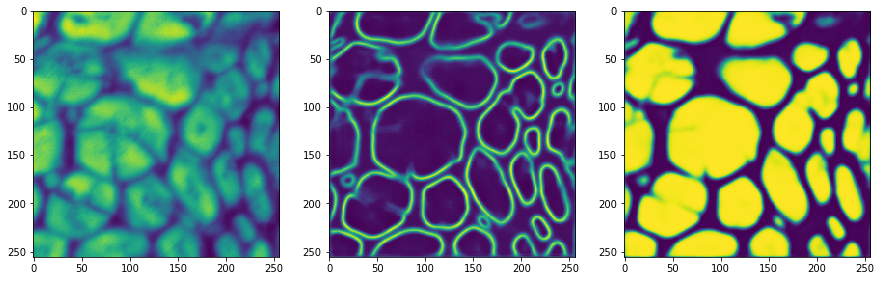

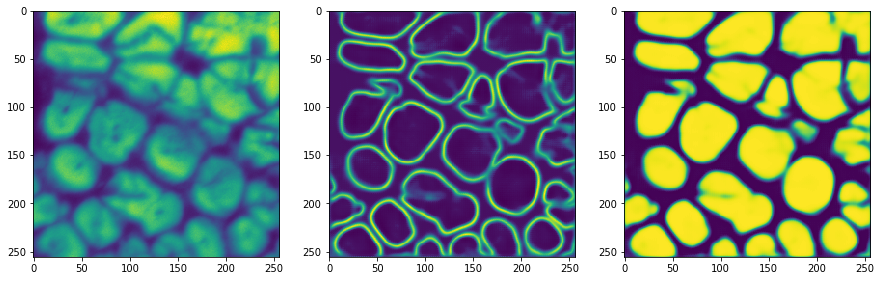

1900
Training loss:  0.022841232
(3, 256, 256, 2)
Validation loss:  0.07465353


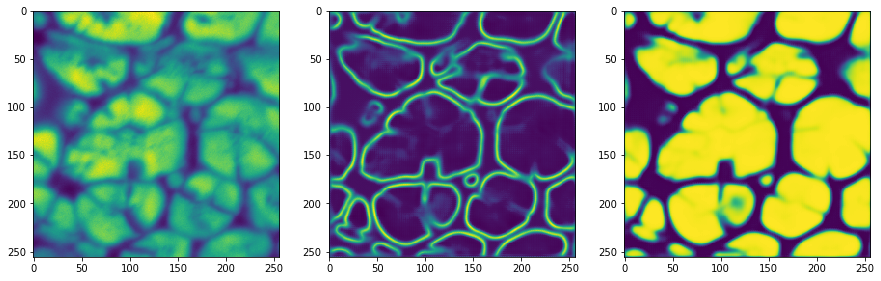

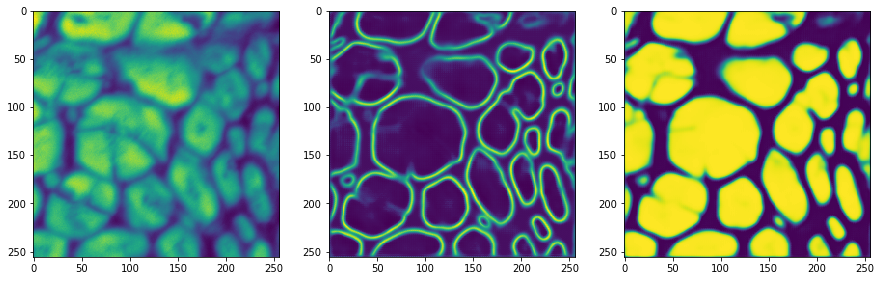

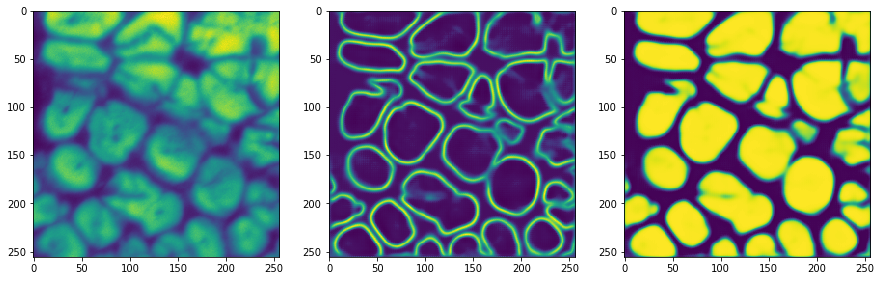

2000
Training loss:  0.03198694
(3, 256, 256, 2)
Validation loss:  0.07522903


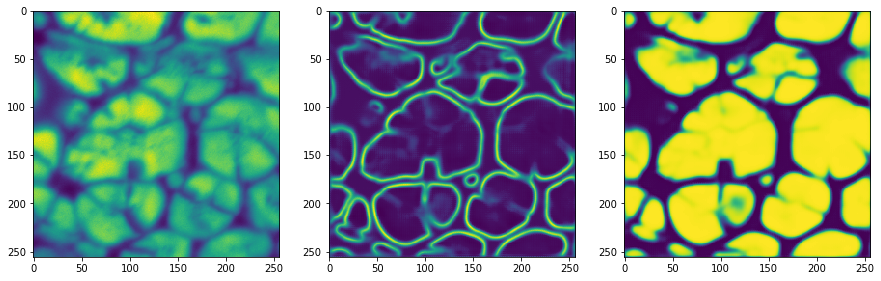

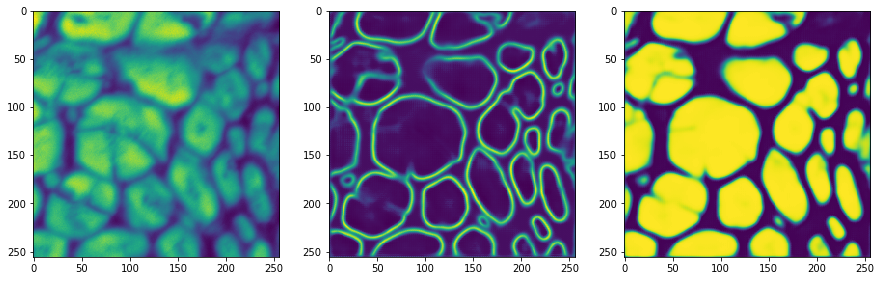

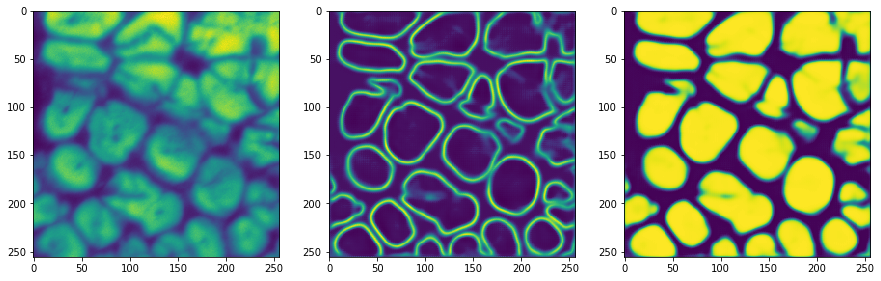

2100
Training loss:  0.037034094
(3, 256, 256, 2)
Validation loss:  0.07507049


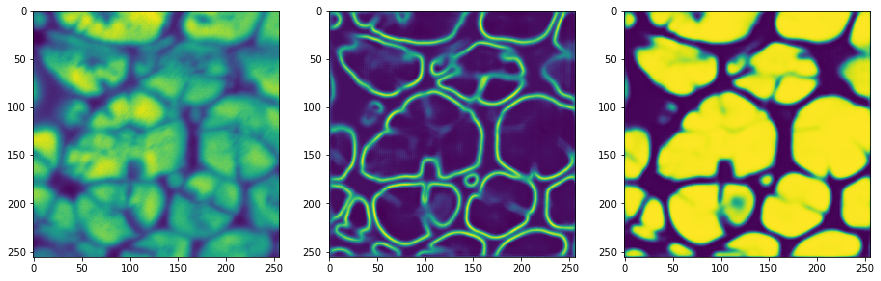

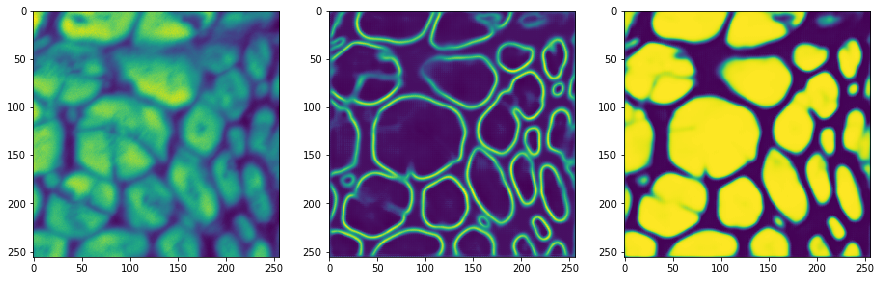

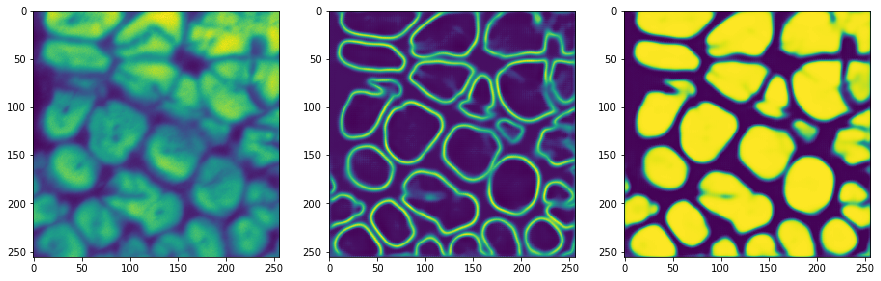

In [164]:
shutil.rmtree('./logs/')
tf.set_random_seed(123456)
sess=tf.Session()
sess.run(tf.global_variables_initializer())
saver = tf.train.Saver(max_to_keep=50)
#train_writer = tf.summary.FileWriter('./logs/1/train ', sess.graph)
test_writer = tf.summary.FileWriter('./logs/170/test')
current_best=[0,1000000000]


learning_rates=[0.000195, 0.0001, 0.00002, 0.00001]
learning_rate_steps=[500,1500, 2200, 2200]
current_step=0
for lrate, lrs in zip(learning_rates, learning_rate_steps):
    for i in range(current_step, lrs):
        idx=np.random.choice(train_data.shape[0], replace=False, size=[25])
        cur_train=train_data[idx,:,:,:]+np.random.uniform(-baseline_noise, baseline_noise, 1)
        cur_truth=train_truth[idx,:,:]
        _, results, losses=sess.run([train_op,  probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})
        #train_writer.add_summary(summary, i)
        if (i%100==0):
            print(i)
            print("Training loss: ",losses)
            #idx=np.random.choice(validation_data.shape[0], replace=False, size=[50])
            idx=range(0,3, 1)
            sub_validation_data=validation_data[idx, :,:,:]
            sub_validation_truth=validation_truth[idx, :,:]
            summary, results, losses, a,c,cc=sess.run([merge, probs, loss, A1,C2,CC2], feed_dict={x:sub_validation_data, y:sub_validation_truth})
            test_writer.add_summary(summary, i)
            print(results.shape)
            print("Validation loss: ",losses)
            if (losses<current_best[1]):
                current_best=[i, losses]
                file=open(data+'Network.txt', 'w')
                file.write(str(base_scaler)+'\n')
                file.write(str(baseline_noise)+'\n')
                file.write(str(x_dim)+'\n')
                file.write(str(mean)+'\n')
                file.write(str(std)+'\n')
                file.write(str(i)+'\n')
                file.close()
            for ti in range (0,3):
                utils.plot_3x1(sub_validation_data[ti,:,:,0], results[ti,:,:,0], results[ti,:,:,1])
                plt.show()
            saver.save(sess, data+'NewModels/Model'+str(i))
    current_step=lrs

In [21]:
tf.train.write_graph(sess.graph_def, 'Data/NewModels/', 'saved_3100.pb', as_text=False)

'Data/NewModels/saved_3100.pb'

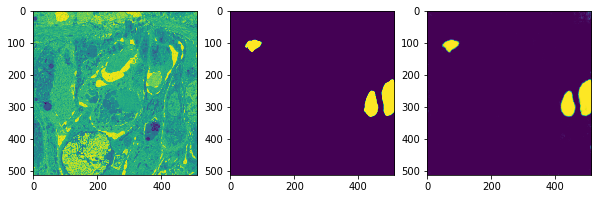

In [31]:
idx=np.random.choice(validation_data.shape[0], replace=False, size=[25])
cur_train=train_data[idx,:,:,:]
cur_truth=train_truth[idx,:,:]
results, losses=sess.run([probs, loss], feed_dict={x:cur_train, y:cur_truth, lr:lrate})

ids=4
utils.plot_3x1(cur_train[ids,:,:,0], cur_truth[ids,:,:,0], results[ids,:,:,0])

# Process new datafiles using trained network

Load the network that works best

In [165]:
file=open(data+'Network.txt')
base_scaler=int(file.readline())
baseline_noise=float(file.readline())
x_dim=int(file.readline())
mean=float(file.readline())
std=float(file.readline())
model=int(file.readline())
file.close()

In [166]:
saver = tf.train.Saver()
sess=tf.Session()
sess.run(tf.global_variables_initializer())

data_model=data+'NewModels/Model'+str(model)
saver.restore(sess,data_model)

Function for processing a file

In [189]:
def process_file(sess, file_path, save_dir):
    file_data=skimage.external.tifffile.imread(file_path)
    file_data=np.reshape(file_data, [file_data.shape[0], x_dim, x_dim, 1])
    inference_data=file_data[:,:,:,[0]]/655350.0
    file_data=0
    
    #true_test2_data=true_test2_data/np.std(true_test2_data)*0.02
    #true_test2_data=true_test2_data-np.mean(true_test2_data)+0.55
    #v1true_test2_data=(true_test2_data-.578)/.138+0.5
    inference_data=(inference_data-mean)/std+0.5

    num_images=inference_data.shape[0]
    output=np.zeros([num_images,x_dim,x_dim,3])
    process_batch_size=20
    print('Starting')
    for t in range(0,num_images,process_batch_size):
        endrng=np.min((t+process_batch_size,num_images))
        inference_batch_data=inference_data[t:(t+process_batch_size), :,:,:]
        results=sess.run(probs, feed_dict={x:inference_batch_data})
        output[t:(t+process_batch_size),:,:,0]=inference_batch_data[:,:,:,0]
        output[t:(t+process_batch_size),:,:,1]=results[:,:,:,0]
        output[t:(t+process_batch_size),:,:,2]=results[:,:,:,1]
    print('Done')
    inference_data=0
    output=np.swapaxes(np.swapaxes(output,3,2),2,1)
    #np.place(output, output<0, 0)
    file_name=file_path.split('/')[-1]
    print(output.dtype)
    skimage.external.tifffile.imsave(save_dir+file_name, output.astype('float32'), imagej=True)
    print('Written')
    return output


In [183]:
output=process_file(sess,data+'Inference/Img000.tif')

TypeError: process_file() missing 1 required positional argument: 'save_dir'

In [191]:
import glob
for f in glob.glob(data+'Data_input/*'):
    output=process_file(sess, f, data+'Data_output/')

Starting
Done
float64
Written


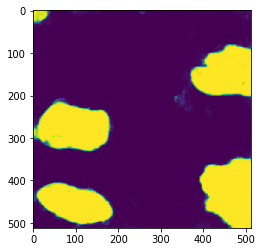

In [22]:
plt.imshow(output[10,:,:,1])